# Metropolis-Hastings animation

**The Metropolis-Hastings algorithm** adopts the following acceptance probability for newly proposed points to step to:

$$ p_{\rm acc}(\theta_i,\theta_{i+1}) = { p(\theta_{i+1}) \over p(\theta_i) }, $$

where the proposed point $\theta_{i+1}$ is drawn from an *arbitrary* symmetric density distribution $T(\theta_{i+1}\,|\,\theta_i)$. Since it is symmetric, the **ratio of transition probabilities cancels out and detailed balance is ensured**. A Gaussian distribution centered on the current point $\theta_i$ is often used for $T(\theta_{i+1}|\theta_i)$.

This algorithm guarantees that the chain will reach an equilibrium, or stationary, distribution, and it will approximate a sample drawn from $p(\theta)$! 

**In summary, the Metropolis-Hastings algorithm consists of these steps:**

1. Given $\theta_i$ and $T(\theta_{i+1}|\theta_i)$, draw a proposed value for $\theta_{i+1}.$ 
2. Compute acceptance probability $p_{\rm acc}(\theta_i,\theta_{i+1})$.
3. Draw a random number between 0 and 1 from a uniform distribution; if it is smaller than $p_{\rm acc}(\theta_i,\theta_{i+1})$, then accept $\theta_{i+1}$. 
4. ***If $\theta_{i+1}$ is accepted added it to the chain. If not, add $\theta_{i}$ to the chain.***
5. Use the chain (of $\theta$ values) for inference; e.g. a histogram of $\theta$ is an estimator of the posterior pdf for $\theta$, $p(\theta)$, and the expectation value for $\theta$ can be computed from 

  $$ I = \int g(\theta) \, p(\theta) \, d\theta = \frac{1}{N} \sum_{i=1}^N g(\theta_i).$$

where N is the number of elements in the chain (e.g. the expectation value for $\theta$ is simply the mean value of chain elements). 

***Step 4*** is very important. If we only accepted points of higher probability then we would only move up the posterior density to find its maximum. But we want to map out the full posterior density, so sometimes we must settle for less!

In [129]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from matplotlib.patches import FancyArrowPatch

from scipy.stats import norm
from scipy.stats import multivariate_normal

# Target distribution: mixture of two Gaussians
def target_pdf(x):
    gauss1 = multivariate_normal(mean=[1, 0], cov=[[0.3, 0], [0, 0.3]])
    gauss2 = multivariate_normal(mean=[-1, 1], cov=[[0.5, 0], [0, 0.5]])
    return gauss1.pdf(x) + gauss2.pdf(x)

In [29]:
# Initialize sampling
samples = [[0.0, 0.0]]
proposal_std = 1

fig, ax = plt.subplots(figsize=(8, 8))

# Plot target PDF background
x = np.linspace(-3, 3, 200)
y = np.linspace(-3, 3, 200)
X, Y = np.meshgrid(x, y)
pos = np.dstack((X, Y))
Z = np.array([target_pdf(p) for p in pos.reshape(-1, 2)]).reshape(200, 200)
ax.imshow(Z, extent=[-3, 3, -3, 3], origin='lower', cmap='viridis', alpha=0.5)
ax.set_title("Metropolis-Hastings Sampling")
ax.set_xlim(-3, 3)
ax.set_ylim(-3, 3)

# Plot elements
scat = ax.scatter([], [], color='red', s=10)
path_line, = ax.plot([], [], color='white', lw=0.5)
arrow = FancyArrowPatch((0, 0), (0, 0), arrowstyle="->", color='gray', mutation_scale=15)
ax.add_patch(arrow)

# Text annotations
text_current = ax.text(0, 0, '', color='white', fontsize=8)
text_proposal = ax.text(0, 0, '', color='white', fontsize=8)
text_alpha = ax.text(0, 0, '', color='white', fontsize=8)

def init():
    scat.set_offsets(np.empty((0, 2)))
    path_line.set_data([], [])
    arrow.set_positions((0, 0), (0, 0))
    arrow.set_visible(False)
    text_current.set_text('')
    text_proposal.set_text('')
    text_alpha.set_text('')
    return scat, path_line, arrow, text_current, text_proposal, text_alpha

def update(frame):
    current = samples[-1]
    proposal = current + np.random.normal(scale=proposal_std, size=2)

    p_current = target_pdf(np.array(current))
    p_proposal = target_pdf(np.array(proposal))
    alpha = min(1, p_proposal / p_current)

    # Accept/reject logic
    if np.random.rand() < alpha:
        samples.append(proposal)
        arrow.set_color('green')
    else:
        samples.append(current)
        arrow.set_color('red')

    # Update scatter and path
    path = np.array(samples)
    scat.set_offsets(path)
    path_line.set_data(path[:, 0], path[:, 1])

    # Update arrow and make visible
    arrow.set_positions((current[0], current[1]), (proposal[0], proposal[1]))
    arrow.set_visible(True)

    # Annotate with probabilities
    mid_x = (current[0] + proposal[0]) / 2
    mid_y = (current[1] + proposal[1]) / 2

    text_current.set_position((mid_x + 0.1, mid_y + 0.1))
    text_current.set_text(f"p(current)={p_current:.3f}")

    text_proposal.set_position((mid_x + 0.1, mid_y))
    text_proposal.set_text(f"p(proposal)={p_proposal:.3f}")

    text_alpha.set_position((mid_x + 0.1, mid_y - 0.1))
    text_alpha.set_text(f"p(acc)={alpha:.3f}")

    return scat, path_line, arrow, text_current, text_proposal, text_alpha

ani = FuncAnimation(
    fig, update, init_func=init,
    frames=100, interval=200, blit=False
)

display(HTML(ani.to_jshtml()))
plt.close()
    


In [130]:

# constants

h = 6.67e-27           # cgs
k_B = 1.38e-16         # cgs
c = 2.99e10            # cm/s
parsec = 3.086e+18     # cm
T_sun = 5778           # K
R_sun = 6.96e10        # cm


def calzetti_extinction(wavelength, R_V=4.05):
    wavelength = np.atleast_1d(wavelength)
    k_lambda = np.zeros_like(wavelength)
    
    # UV to optical: 0.12 µm ≤ λ < 0.63 µm
    uv_opt_mask = (wavelength >= 0.12) & (wavelength < 0.63)
    lambda_uv_opt = wavelength[uv_opt_mask]
    k_lambda[uv_opt_mask] = (
        2.659 * (-2.156 + 1.509 / lambda_uv_opt - 0.198 / lambda_uv_opt**2 + 0.011 / lambda_uv_opt**3) + R_V
    )
    
    # Optical to NIR: 0.63 µm ≤ λ ≤ 2.2 µm
    opt_nir_mask = (wavelength >= 0.63) & (wavelength <= 2.2)
    lambda_opt_nir = wavelength[opt_nir_mask]
    k_lambda[opt_nir_mask] = (
        2.659 * (-1.857 + 1.040 / lambda_opt_nir) + R_V
    )

    return k_lambda[0] if wavelength.size == 1 else k_lambda

def model(w,T_star,R_star,EBmV,distance):
    """
    Perfect black body of temperature T and emitting surface R at distance d + dust extinction
    w in Armstrong
    T_star in K
    R_star in solar radii
    EBmV dimensionless
    distance in parsec
    returns observed specific flux in erg/s/cm^2/angstrom
    """
    w_cm = w * 1e-8         # wavelength converted from angstrom to cm
    R_star = R_star * R_sun
    distance = distance * parsec
    
    black_body = (2 * h * c**2) / (w_cm**5) * 1 / (np.exp((h * c) / (w_cm * k_B * T_star)) - 1)

    intrinsic_flux = 1e-8 * (R_star**2/distance**2) * np.pi * black_body

    w_micron = w * 1e-4 
    extinction = np.exp(-calzetti_extinction(w_micron,4.1) * EBmV)

    return intrinsic_flux * extinction



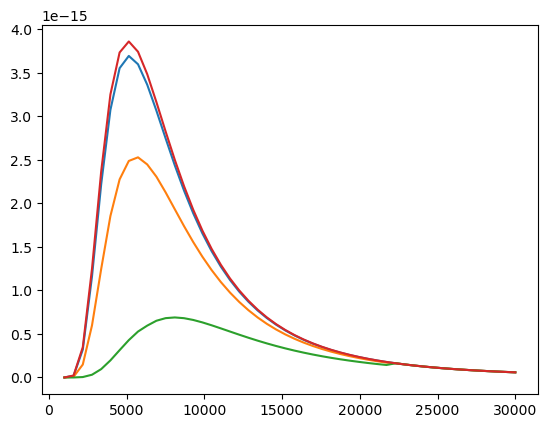

In [131]:
w = np.linspace(1000,30000)
for EBmV in [0.01,0.1,0.5,0]:
    plt.plot(w,model(w,T_star=5700,R_star=1,EBmV=EBmV,distance=1000))


<ErrorbarContainer object of 3 artists>

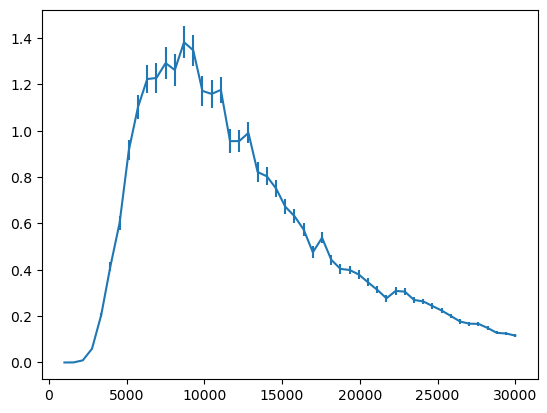

In [147]:
# build fake data adding noise to the spectrum
flux = model(w,T_star=5700,R_star=1,EBmV=0.5,distance=1000) * 1e15

noise = norm(loc=flux, scale=0.1*flux).rvs() 
data = [w,flux+noise,0.1*flux]

plt.errorbar(data[0],data[1],data[2],linestyle='-')



## Maximum a posterior (MAP)

Bayes' Theorem:

$$ \mathrm{Posterior} = \frac{\mathrm{Likelihood}\times\mathrm{Prior}}{\mathrm{Evidence}} $$

$$p(M,\theta \,|\,D,I) = \frac{p(D\,|\,M,\theta,I)\,\times p(M,\theta\,|\,I)}{p(D\,|\,I)},$$

Assume $N$ measurements of the flux at $N$ different wavelenghts $\lambda_i$, where the uncertainty for each measurement is Gaussian with a known $\sigma_i$ (the flux error). The likelihood of one measurement is 

$$L \equiv p(x(\lambda_i)|\mu(\lambda_i),\sigma_i) = \frac{1}{\sigma_i\sqrt{2\pi}} \exp\left(\frac{-(x(\lambda_i)-\mu(\lambda_i))^2}{2\sigma_i^2}\right).$$

where $\mu(\lambda_i) = M(\theta,\lambda_i)$ is the model evaluated at each wavelength, for a given set of parameters.


and therefore the likelihood of all N measurements is

$$L \equiv p(\{x_i\}|\mu,\sigma_i) = \prod_{i=1}^N \frac{1}{\sigma_i\sqrt{2\pi}} \exp\left(\frac{-(x(\lambda_i)-\mu(\lambda_i))^2}{2\sigma_i^2}\right).$$


In [133]:

def LogLikelihood(params, data):
    T_star, R_star, EBmV = params
    model_arr = model(data[0], T_star, R_star, EBmV, distance=1000)
    residual = data[1] - model_arr
    logL = -0.5 * np.sum((residual / data[2])**2 + np.log(2 * np.pi * data[2]**2))
    return logL


def LogPrior(params): 
    T_star, R_star, EBmV = params[0],params[1],params[2]
    if T_star < 1e3 or T_star > 4e4 or R_star < 0.1 * R_sun or R_star > 1e3 * R_sun or EBmV < 0 or EBmV > 0.5:
        return -np.inf
    else:
        return 0  

def LogPosterior(params,data):
    return LogPrior(params) + LogLikelihood(params, data)


In [184]:
def Metropolis_Hastings(data, N, params_init, proposal_std, prior_space, param_names):
    
    ndims = len(params_init)
    samples = [params_init]

    for i in range(N):
        current = samples[-1]
        proposal = current + np.random.normal(loc=0, scale=proposal_std, size=ndims)

        log_p_current = LogPosterior(current, data)
        log_p_proposal = LogPosterior(proposal, data)

        alpha = min(1, np.exp(log_p_proposal - log_p_current))
        samples.append(proposal if np.random.rand() < alpha else current)
        
    return samples
    

In [196]:
params_init = [5000,1,0.5]
proposal_std = [100,0.05,0.01]
prior_space = [[3000,7000],[0.1,3],[0.3,0.7]]

samples = Metropolis_Hastings(data,500,params_init=params_init,proposal_std=proposal_std,prior_space=prior_space,param_names=['T','R','EBmV'])

/tmp/ipykernel_28130/1883467664.py:13: RuntimeWarning: invalid value encountered in scalar subtract
  alpha = min(1, np.exp(log_p_proposal - log_p_current))


In [197]:
T = [s[0] for s in samples]
R = [s[1] for s in samples]
EBmV = [s[2] for s in samples]

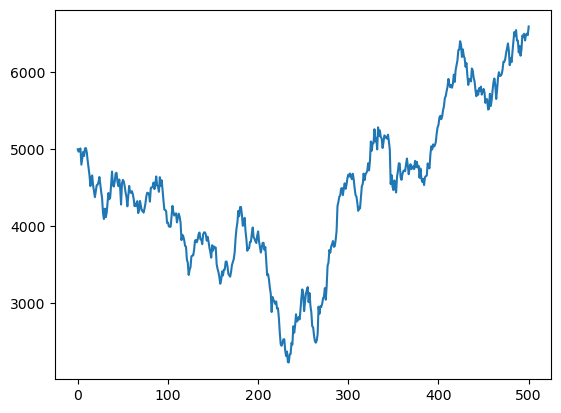

In [198]:
plt.plot(np.arange(0,len(T),1),T)

In [181]:
def Animated_Metropolis_Hastings(data, N, params_init, proposal_std, prior_space, param_names):
    from IPython.display import HTML, display
    import matplotlib.pyplot as plt
    import numpy as np
    from matplotlib.animation import FuncAnimation

    ndims = len(params_init)
    samples = [params_init]

    fig, axes = plt.subplots(ndims - 1, ndims - 1, figsize=(2 * ndims, 2 * ndims))
    scatters = [[None for _ in range(ndims - 1)] for _ in range(ndims - 1)]  # store scatter plots

    # Configure axes
    for i in range(ndims - 1):
        for j in range(ndims - 1):
            ax = axes[i, j]
            if i < j:
                ax.set_visible(False)
            else:
                ax.set_xlim(prior_space[j][0], prior_space[j][1])
                ax.set_ylim(prior_space[i + 1][0], prior_space[i + 1][1])
                if j == 0:
                    ax.set_ylabel(param_names[i + 1])
                if i == ndims - 2:
                    ax.set_xlabel(param_names[j])

    plt.tight_layout()

    # Initialize scatter plots for lower triangle
    for i in range(1, ndims):
        for j in range(i):
            scatters[i - 1][j] = axes[i - 1][j].scatter([], [], s=2, c='grey')

    def init():
        for i in range(1, ndims):
            for j in range(i):
                scatters[i - 1][j].set_offsets(np.empty((0, 2)))
        return [scatters[i - 1][j] for i in range(1, ndims) for j in range(i)]

    def update(frame):
        current = samples[-1]
        proposal = current + np.random.normal(loc=0, scale=proposal_std, size=ndims)

        log_p_current = LogPosterior(current, data)
        log_p_proposal = LogPosterior(proposal, data)

        alpha = min(1, np.exp(log_p_proposal - log_p_current))
        samples.append(proposal if np.random.rand() < alpha else current)

        path = np.array(samples)
        for i in range(1, ndims):
            for j in range(i):
                scatters[i - 1][j].set_offsets(path[:, [j, i]])

        return [scatters[i - 1][j] for i in range(1, ndims) for j in range(i)]

    ani = FuncAnimation(
        fig, update, init_func=init,
        frames=N, interval=100, blit=False
    )

    display(HTML(ani.to_jshtml()))
    plt.close()

    return samples




In [183]:
params_init = [5000,1,0.5]
proposal_std = [100,0.05,0.01]
prior_space = [[3000,7000],[0.1,3],[0.3,0.7]]

samples = Animated_Metropolis_Hastings(data,1000,params_init=params_init,proposal_std=proposal_std,prior_space=prior_space,param_names=['T','R','EBmV'])



/tmp/ipykernel_28130/2990679536.py:47: RuntimeWarning: invalid value encountered in scalar subtract
  alpha = min(1, np.exp(log_p_proposal - log_p_current))
Animation size has reached 20989067 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


In [70]:
print(LogPosterior([5700,R_sun,0.5],data))

-255299.58102628367


In [71]:
print(LogPosterior([5000,R_sun,0.5],data))

-608062.7425976109


In [72]:
print(LogPosterior([5900,R_sun,0.5],data))

-150240.2294487485


In [95]:
print(np.empty((0,3)[1]))

[43.55555556 43.55555556 43.55555556]


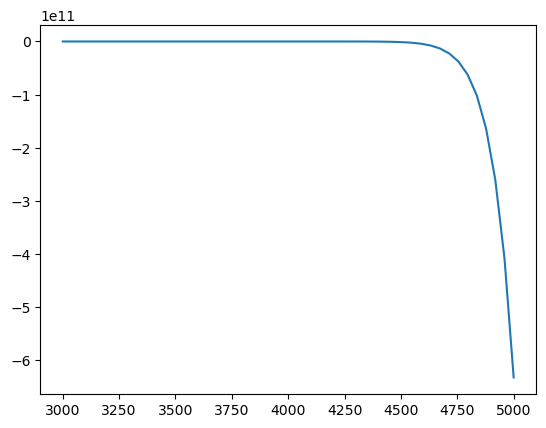

In [78]:
log_p = []
for T in np.linspace(3000,9000):
    #print(LogPosterior([T,R_sun,0.5,1000],data))
    log_p.append(LogPosterior([T,R_sun,0.5],data))

plt.plot(np.linspace(3000,5000),log_p)

In [79]:
np.argmax(log_p)

24

In [80]:
w[24]

5408.163265306122

In [81]:
w[26]

5775.510204081633